Mask R-CNN + FCN - Test on COCO Dataset - Run the Mask R-CNN net in inference mode, with the additional PCILayer that generates the context-based tensor 

# Setup Pipeline -  (build model and load weights)

In [3]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
%matplotlib inline
%load_ext autoreload
%autoreload 2
import sys,os, pprint
pp = pprint.PrettyPrinter(indent=2, width=100)
print('Current working dir: ', os.getcwd())
if '..' not in sys.path:
    print("appending '..' to sys.path")
    sys.path.append('..')
    
import numpy as np
import mrcnn.utils     as utils
import mrcnn.visualize as visualize
from mrcnn.prep_notebook import build_fcn_evaluate_pipeline, run_mrcnn_evaluate_pipeline, get_evaluate_batch
from mrcnn.visualize     import display_training_batch
from mrcnn.coco          import prep_coco_dataset
                             
# WEIGHT_FILE = 'F:/models/train_fcn8_coco_adam/fcn20181109T0000/fcn_0900.h5'
WEIGHT_FILE = 'last'
##------------------------------------------------------------------------------------
## Parse command line arguments
##------------------------------------------------------------------------------------
parser = utils.command_line_parser()
input_parms  =" --batch_size     1  "
input_parms +=" --mrcnn_logs_dir train_mrcnn_coco "
input_parms +=" --fcn_logs_dir   train_fcn8_bce " 
# input_parms +=" --fcn_logs_dir   train_fcn8_coco_adam "
input_parms +=" --mrcnn_model    last "
# input_parms +=" --fcn_model      " + WEIGHT_FILE + "  "
input_parms +=" --fcn_model      last "
input_parms +=" --fcn_layer      all"
input_parms +=" --fcn_arch       fcn8 " 
input_parms +=" --sysout         screen "
input_parms +=" --scale_factor   4"
# input_parms +=" --coco_classes   78 79 80 81 82 44 46 47 48 49 50 51 34 35 36 37 38 39 40 41 42 43 "
input_parms +=" --coco_classes       78 79 80 81 82 44 46 47 48 49 50 51 34 35 36 37 38 39 40 41 42 43 10 11 13 14 15 "

args = parser.parse_args(input_parms.split())
utils.display_input_parms(args)


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Current working dir:  E:\git_projs\MRCNN3\notebooks

Arguments passed :
--------------------
batch_size                     1
coco_classes                   [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
epochs                         1
fcn_arch                       FCN8
fcn_layers                     ['all']
fcn_logs_dir                   train_fcn8_bce
fcn_losses                     fcn_BCE_loss
fcn_model                      last
last_epoch                     0
lr                             0.001
mrcnn_exclude_layers           None
mrcnn_logs_dir                 train_mrcnn_coco
mrcnn_model                    last
new_log_folder                 False
opt                            ADAGRAD
scale_factor                   4
steps_in_epoch                 1
sysout                         SCREEN
val_steps                      1




In [4]:
mrcnn_model, fcn_model = build_fcn_evaluate_pipeline(args = args,verbose = 0)


--> Execution started at: 12-16-2018 @ 13:43:44
    Tensorflow Version: 1.8.0   Keras Version : 2.2.0 

Arguments passed :
--------------------
batch_size                     1
coco_classes                   [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
epochs                         1
fcn_arch                       FCN8
fcn_layers                     ['all']
fcn_logs_dir                   train_fcn8_bce
fcn_losses                     fcn_BCE_loss
fcn_model                      last
last_epoch                     0
lr                             0.001
mrcnn_exclude_layers           None
mrcnn_logs_dir                 train_mrcnn_coco
mrcnn_model                    last
new_log_folder                 False
opt                            ADAGRAD
scale_factor                   4
steps_in_epoch                 1
sysout                         SCREEN
val_steps                      1


 *** Keras Training mode: 0
 *** Keras Trai


   --- FCN32 ----------------------------
***** Call to Dropout Layer : Training is :  None
***** in_train_phase() : Use_learning_phase:  True
***** Call to Dropout Layer : Training is :  None
***** in_train_phase() : Use_learning_phase:  True

   --- FCN16 ----------------------------

   --- FCN8 ----------------------------




 
----------------------
>>> FCN Scoring Layer - mode: inference
----------------------
    in_heatmap.shape               :  shape: (?, 256, 256, 81)     KB.shape:(None, 256, 256, 81)  Keras Tensor: True
    pr_hm_scores.shape             :  shape: (?, 81, 200, 24)      KB.shape:(None, 81, 200, 24)   Keras Tensor: True
    detctions_per_image :  200 pr_scores shape (?, 81, 200, 24)
    rois_per_image      :  200
    config.DETECTION_MAX_INSTANCES   :  200
    config.DETECTIONS_PER_CLASS      :  200
    sequence_column                  :  7
    norm_score_column                :  8
    in_heatmap                     :  shape: (?, 256, 256, 81)     KB.shape:(

##  Print some information about the model 

In [ ]:
# for layer in model.keras_model.layers
#     print layer.name 

layers    = [layer for layer in mrcnn_model.keras_model.layers]          # all layer outputs
print(len(layers))

for idx in range(200, len(layers)):
    print( ' layer: {} name: {}'.format(idx, layers[idx].name))
#     print(' layer {} :  {}'.format(idx,layers[idx]))
#     print(' Number of inbound nodes: ', end ='')
#     pp.pprint(len(layers[idx]._inbound_nodes))
#     pp.pprint(layers[idx].__dict__)
#     print('-------------------------------------------')
print('idx : ', idx)
pp.pprint(layers[idx].__dict__)

print()
pp.pprint(layers[idx]._inbound_nodes[0].__dict__)

####  Print Layer & Weight Info

In [ ]:
# keras_model = mrcnn_model.keras_model
# layers = keras_model.inner_model.layers if hasattr(keras_model, "inner_model") else keras_model.layers
# print(dir(layers[0]))
# pp.pprint(layers[7].weights)
print()
for i in range(len(layers)):
    print('\n{:3d} {:20s} Weights: {}'.format(i, layers[i].name, len(layers[i].weights))) ## [weight.name for weight in layers[i].weights]))
    print('{:23s}  Trainable: {} '.format(' ',[weight.name for weight in layers[i].trainable_weights]))
    for weight in layers[i].weights:
        print('{:25s} {:30s} {}  '.format(' ',weight.name,  weight.shape))

####  More layer information

In [ ]:
import pprint
pp = pprint.PrettyPrinter(indent=2, width=100)
np.set_printoptions(linewidth=100,precision=4,threshold=1000, suppress = True)

# model.compile_only(learning_rate=config.LEARNING_RATE, layers='heads')
# print('\n Metrics (_get_deduped_metrics_names():) ') 
# pp.pprint(mm._get_deduped_metrics_names())
# print('\n Losses (model.metrics_names): ') 
# pp.pprint(mm.metrics_names)
# KB.set_learning_phase(0)
# print(' Learning phase values is L ' ,KB.learning_phase())
# print('\Layers ', len(mrcnn_model.keras_model.layers))
# pp.pprint(mrcnn_model.keras_model.layers)

print('\n Weights: ') 
## Get weieights acturally returns weight dims
# print(' Number of weights arrays: ',len(mrcnn_model.keras_model.get_weights()))
print(' length of model.keras_model.weights', len(mrcnn_model.keras_model.weights))
# for i,j in enumerate(mrcnn_model.keras_model.weights):
#     print(i, j) # j.name, j.shape, j.dtype)
# pp.pprint(mrcnn_model.keras_model.weights)
# pp.pprint(type(mrcnn_model.keras_model.get_weights()))

# pp.pprint(dir(model.keras_model))
# print(mrcnn_model.keras_model.weights[1])

#### List trainable layers using `get_trainable_layers()`

In [ ]:
for i in  mrcnn_model.get_trainable_layers():
    print(' Layer:', i.name)       

####  Get a list of trainable layers, i.e., layers that have weights

In [ ]:
# trainable = mrcnn_model.get_trainable_layers()
layers    = [layer for layer in mrcnn_model.keras_model.layers]          # all layer outputs
print('Trn  Idx   Layer Name   \t\t InputNode LayerNames \t\t InputNode LayerShapes')
for idx, layer in enumerate(layers):
    TrnFlg = 'T' if layer.get_weights() else ' '
    all_input_shapes = [node.input_shapes   for node in layer._inbound_nodes][0]
    input_nodes  = [node for node in layer._inbound_nodes]
    all_nodes_layers  = [node.inbound_layers for node in input_nodes]   
#     print(all_input_nodes)
#     all_nodes_layers  = [[node.inbound_layers for node in input_nodes]  for input_nodes in layer._inbound_nodes]  #[node for node in all_input_nodes]]]
    all_input_layer_names = [[layer.name for layer in node_layers] for node_layers in all_nodes_layers][0]        
    str_names = ','.join(map(str, all_input_layer_names)) 
    str_shapes = ','.join(map(str, all_input_shapes)) 
    print(' {} ; {:3d} ; {:25s}; {:30s}; {:30s} '.format( TrnFlg, idx, layer.name,  str_names, str_shapes))

In [ ]:
print()    
for i in range(194,len(layers)):
# for i in [206]:
    layer = layers[i]
    print('====================================================='.format(i))
    print('== Layer {} : {} '.format(i,layer.name))
    print('====================================================='.format(i))
    pp.pprint(layer.__dict__)
    print()
    for j,node in enumerate(layer._inbound_nodes):
        print('== Inbound Node {} ========================================='.format(j))
        print(type(node))
        pp.pprint(node.__dict__)
        node_inlayers_names = [n.name for n in node.inbound_layers]
        print(node_inlayers_names)

## Build test datasets

In [5]:
print('load coco classes: ', args.coco_classes)
load_class_ids = args.coco_classes
dataset_test, test_generator = prep_coco_dataset(["train", "val35k"], mrcnn_model.config, generator = True , return_coco = False, shuffle = False, load_coco_classes =load_class_ids)
# dataset_test, test_generator = prep_coco_dataset(["minival"], mrcnn_model.config, generator = True , return_coco = False, shuffle = False, load_coco_classes =load_class_ids)
# dataset_test.display_class_info()
dataset_test.display_active_class_info()
print("Testing Dataset Image Count: {}".format(len(dataset_test.image_ids)))
print("Testing Dataset Class Count: {}".format(dataset_test.num_classes))
class_names = dataset_test.class_names

load coco classes:  [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
COCO loading annotations file F:\MLDatasets\coco2014\annotations/instances_train2014.json  into memory...
Done (t=20.29s)
creating index...
index created!
 load subset of classes:  [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
 image dir            :  F:\MLDatasets\coco2014\train2014
 json_path_dir        :  F:\MLDatasets\coco2014\annotations/instances_train2014.json
 number of images     :  40400
 image_ids[:10]       :  [262146, 524291, 9, 393227, 393230, 131087, 393241, 393242, 131099, 393251]
 image_ids[1000:1010] :  [396150, 265080, 396157, 2951, 396172, 134032, 134033, 527250, 2963, 2964]
COCO loading annotations file F:\MLDatasets\coco2014\annotations/instances_valminusminival2014.json  into memory...
Done (t=8.71s)
creating index...
index created!
 load subset of classes:  [78, 79, 80, 81,

## Display Images

### Load using next(generator)

In [ ]:
test_batch_x, _ = next(test_generator)
display_training_batch(dataset_test, test_batch_x)
# dataset_train.display_annotation_info(0)

### Load a specific image using image_id -Display image with Ground Truth bounding boxes and masks

 Image_id    :  30533  Reference:  http://cocodataset.org/#explore?id=488487 Coco Id: 488487
 Image meta  :  [30533   480   640     3   128     0   896  1024]
 Class ids   :  (5,)    [ 1 35 36  1  1]
 Class Names :  ['person', 'baseball bat', 'baseball glove', 'person', 'person']


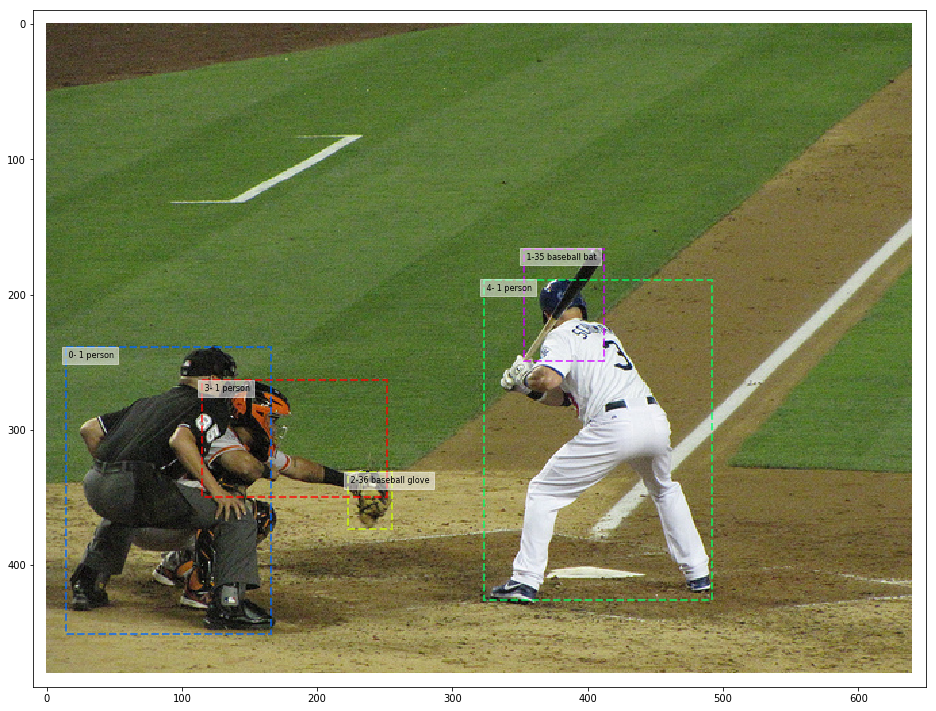

In [6]:
## 62642 (persons),   68539 (trucks) 36466 (surfers)  75040 (boat and persons)
## 36466 surfers. 5498 basketbal players, 27711,30531
## 5498 lots of motorcylces & persons - 
## Persons: #26026, #7719, 111864, 58240,  
## 35347 - laptops, keyboards and cat
## items = [59199 , 102868]
## 89243: Person, bicylce and traiffic lights
## 101623 (cake and forks), 41423 (elephant & people)
## 33477 Table, bowl, cup, sandwich, knife
## 26763 Table, chair, cup , bowl, bottle
## 49316 Table, book, backpack, many bottles
## 12902 Car , truck and traffic light tree
## 57327 person and horses
## 26026 -- mountain, skiers, skiboards 
##  7719 -- people, bottles, handbags
## 27711 -- persons and boats
## 18045 -- person     
## 36769 -- people in meeting room with a 'giraffe'detection?
##  8634 -- person
## 30531 -- tennis players 
##  8645 -- two people
# IMAGE_LIST = [75040] 
# IMAGE_LIST = [89243]
# IMAGE_LIST = [33477]
# IMAGE_LIST = [29731]
# IMAGE_LIST = [26763]
# IMAGE_LIST = [89243]   ## 89243: Person, bicylce and traiffic lights
# IMAGE_LIST = [43168]   ## 43168 Multiple umbrella, chairs, beds

# IMAGE_LIST = [10]
IMAGE_LIST = [30533]
# IMAGE_LIST= [30531]
# IMAGE_LIST= [7143]
# del images, train_batch_x
# train_batch_x = get_evaluate_batch(dataset_train, mrcnn_model.config, generator = train_generator )
eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, image_ids = IMAGE_LIST)

# train_batch_x, _ =  data_gen_simulate(dataset_train, mrcnn_model.config, IMAGE_LIST)
# visualize.display_training_batch(dataset_train, train_batch_x)
# dataset_train.display_annotation_info(IMAGE_LIST)
 

### Load an image using `get_evaluate_batch()`

 Random selection of images:  [44236]
 Image_id    :  44236  Reference:  http://cocodataset.org/#explore?id=269395 Coco Id: 269395
 Image meta  :  [     44236        338        451          3        128          0        895       1024]
 Class ids   :  (7,)    [        44         46         46         56         61         61         74]
 Class Names :  ['knife', 'bowl', 'bowl', 'cake', 'dining table', 'dining table', 'book']


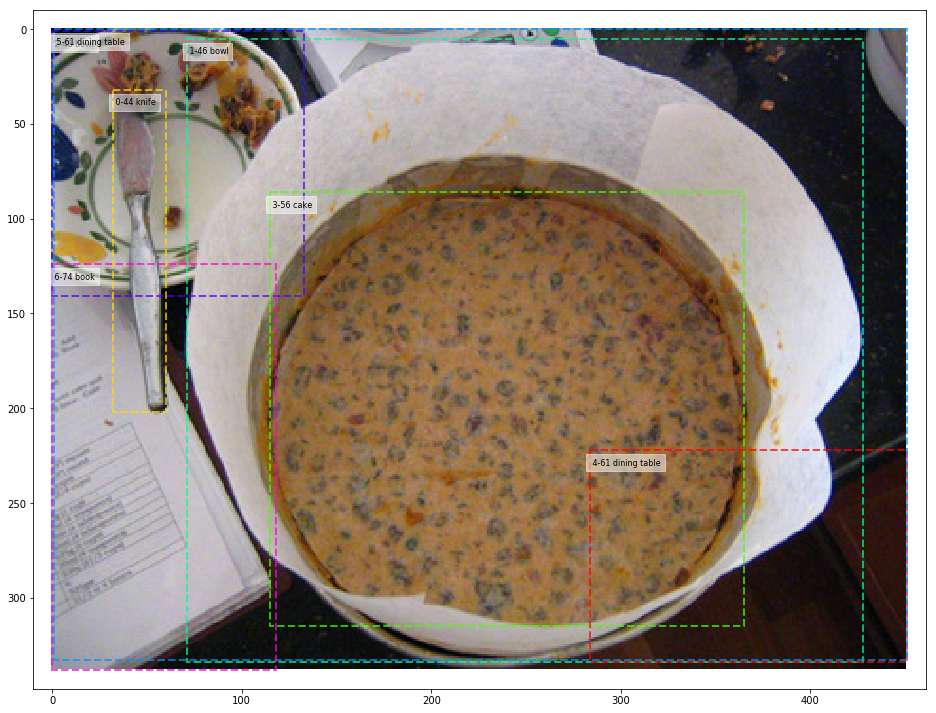

In [25]:
# from mrcnn.prep_notebook import get_evaluate_batch
# from mrcnn.prep_notebook import get_training_batch, get_inference_batch, get_evaluate_batch

# eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, generator = test_generator, display = True)
# eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, image_ids = [7143], display = True)
# eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, display = True)

In [5]:
# import mrcnn.dataset as dataset
# img = dataset.load_image(7143)
# visualize.display_image(img)


# Run FCN evaluation pipeline

##  Run FCN detection pipeline on first image

###  Run `fcn_model.evaluate()`

In [7]:
fcn_results = fcn_model.evaluate(mrcnn_model, eval_batch, verbose = 0)
print(' Complete')

 Max Overlap:  0.05948826
 Complete


In [8]:
fcn_results[0].keys()
for i, r in enumerate(fcn_results):
    print('\n output ', i, '  ',sorted(r.keys()))
    for key in sorted(r):
        print(key.ljust(20), r[key].shape)        


 output  0    ['class_ids', 'detection_ind', 'detections', 'fcn_hm', 'fcn_hm_scores', 'fcn_scores', 'fcn_scores_by_class', 'fcn_sm', 'gt_bboxes', 'gt_class_ids', 'image', 'image_meta', 'molded_image', 'molded_rois', 'pr_hm', 'pr_hm_scores', 'pr_scores', 'pr_scores_by_class', 'rois', 'scores']
class_ids            (10,)
detection_ind        (10,)
detections           (200, 7)
fcn_hm               (256, 256, 81)
fcn_hm_scores        (81, 200, 24)
fcn_scores           (10, 24)
fcn_scores_by_class  (81, 200, 24)
fcn_sm               (256, 256, 81)
gt_bboxes            (100, 4)
gt_class_ids         (100,)
image                (480, 640, 3)
image_meta           (89,)
molded_image         (1024, 1024, 3)
molded_rois          (10, 4)
pr_hm                (256, 256, 81)
pr_hm_scores         (81, 200, 24)
pr_scores            (10, 24)
pr_scores_by_class   (81, 200, 24)
rois                 (10, 4)
scores               (10,)


### Display FCN detections

In [9]:
np_format = {}
float_formatter = lambda x: "%10.4f" % x
int_formatter   = lambda x: "%10d" % x
np_format['float'] = float_formatter
np_format['int']   = int_formatter
np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =10000, formatter = np_format)

In [11]:
# f = fcn_results[0]
# print(f['detections'][:20])
# # print(f['gt_bboxes'][:20])
# print(f['gt_class_ids'])

[[  214.0000   237.0000   594.0000   507.0000     1.0000     0.8490    -1.0000]
 [  336.0000   621.0000   475.0000   840.0000     1.0000     0.8490    -1.0000]
 [  174.0000   759.0000   514.0000  1002.0000     1.0000     0.8490    -1.0000]
 [  430.0000   517.0000   810.0000   787.0000     1.0000     0.8490     1.0000]
 [  549.0000   184.0000   688.0000   403.0000     1.0000     0.8490     1.0000]
 [  510.0000    22.0000   850.0000   265.0000     1.0000     0.8490     1.0000]
 [  498.0000   365.0000   630.0000   459.0000    35.0000     0.7204    -1.0000]
 [  394.0000   565.0000   526.0000   659.0000    35.0000     0.7204     1.0000]
 [  299.0000   616.0000   366.0000   667.0000    36.0000     0.6528    -1.0000]
 [  658.0000   357.0000   725.0000   408.0000    36.0000     0.6528     1.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0

#### Display MRCNN results - 1st style

In [12]:
lmt =17
f = fcn_results[0]

names  = " ".join([ '{:>10s}'.format(class_names[i][-10:]) for i in f['class_ids'][:lmt]])
print('            classes :', f['class_ids'][:lmt])
print('                    : ', names)
print('                    :', f['detection_ind'][:lmt])
print('          bbox area :', f['pr_scores'][:lmt,10])
print('          clip area :', f['pr_scores'][:lmt,13])
print()
print('        orig scores :', f['scores'][:lmt])
print('        norm scores :', f['pr_scores'][:lmt,8])
# print('  pr_scores[5] :', f['pr_scores'][:,5])

print('-'*185)
print('         pr_scrs[8] :', f['pr_scores'][:lmt,11])
print('      fcn_scores[8] :', f['fcn_scores'][:lmt,11])
print()
print('      pr_scores[13] :', f['pr_scores'][:lmt,14])
print('     fcn_scores[13] :', f['fcn_scores'][:lmt,14])
print()

print('      pr_scores[19] :', f['pr_scores'][:lmt,20])
print('     fcn_scores[19] :', f['fcn_scores'][:lmt,20])
print()

print(' norm pr_scores[13] :', f['pr_scores'][:lmt,17])
print('norm fcn_scores[13] :', f['fcn_scores'][:lmt,17])
print()
print(' norm pr_scores[19] :', f['pr_scores'][:lmt,23])
print('norm fcn_scores[19] :', f['fcn_scores'][:lmt,23])


            classes : [         1          1          1          1          1          1         35         35         36         36]
                    :      person     person     person     person     person     person seball bat seball bat ball glove ball glove
                    : [        -1         -1         -1          1          1          1         -1          1         -1          1]
          bbox area : [ 6412.5000  1902.5625  5163.7500  6412.5000  1902.5625  5163.7500   775.5000   775.5000   213.5625   213.5625]
          clip area : [  168.0000    99.0000   168.0000   168.0000    99.0000   168.0000    63.0000    63.0000    36.0000    36.0000]

        orig scores : [    0.8490     0.8490     0.8490     0.8490     0.8490     0.8490     0.7204     0.7204     0.6528     0.6528]
        norm scores : [    1.0000     1.0000     1.0000     1.0000     1.0000     1.0000     1.0000     1.0000     1.0000     1.0000]
--------------------------------------------------------------

####  Display MRCNN scores - 2nd style

In [77]:
# f = fcn_results[0]
# for i, [molded_bbox, cls, scr, pr_scr, fcn_scr] in enumerate(zip(f['molded_rois'].astype(np.int), f['class_ids'],  f['scores'], f['pr_scores'], f['fcn_scores'])):
    
#     print('{} {} {:2d}  {:.<18s}  {:5.4f} {}  '.format(i, molded_bbox, cls, dataset_test.class_names[cls], scr, fcn_scr[[4,5,6,7,8]]))
#     print('{:>86s} {}'.format(' mrcnn old style scores:  ',  pr_scr[[9,10,11]]))
#     print('{:>86s} {}'.format('   fcn old style scores:  ', fcn_scr[[9,10,11]]))
#     print()
#     print('{:>86s} {}'.format('      mrcnn alt scores1:  ', pr_scr[[12,13,14,15,16,17]]))
#     print('{:>86s} {}'.format('        fcn alt scores1:  ', fcn_scr[[12,13,14,15,16,17]]))
#     print()
#     print('{:>86s} {}'.format('          mrcnn_scores2:  ', pr_scr[[18,19,20,21,22,23]]))
#     print('{:>86s} {}'.format('            fcn_scores2:  ', fcn_scr[[18,19,20,21,22,23]]))
#     print()

####  Display MRCNN scores - 3rd style

In [13]:
# r = results[0]
print(f['detections'].shape)
print('   old_scores: (gauss. sum over large bbox/bbox area/ gauss_sum * normlzd_score))')
print('  alt_scores 1: (gauss. sum over small mask/mask area/ gauss_sum / mask_area):  ')
sort_by_class_order = np.argsort(f['class_ids'])


# for i in range(len( f['class_ids'])):
for i in sort_by_class_order:
#     print(i , f['rois'][i].astype(np.float), f['scores'][i], f['class_ids'][i], class_names[f['class_ids'][i]])
#     print(i , f['detections'][i], f['class_ids'][i], class_names[f['class_ids'][i]])
    det_type = '       --> ADDED FP ' if f['pr_scores'][i,6] == -1 else '      Original detection'
    print(i , f['rois'][i])
    print(i , f['pr_scores'][i,:9], f['pr_scores'][i,4], class_names[ f['pr_scores'][i,4].astype(np.int)], det_type) 
    print()
    print(i , 'pr: old_scores [9,10,11]:  '.rjust(90), f['pr_scores'][i,9:12])    
    print(i , '  alt_scores 1 [12 - 17]:  '.rjust(90), f['pr_scores'][i,12:18])    
    print(i , '  alt_scores 2 [18 - 23]:  '.rjust(90), f['pr_scores'][i,18:24])    
    print(i)
#     print(i , f['fcn_scores'][i,:8], f['fcn_scores'][i,4], class_names[ f['fcn_scores'][i,4].astype(np.int)])    
    print(i , 'fcn: old_scores [9,10,11]:  '.rjust(90), f['fcn_scores'][i,9:12])    
    print(i ,  '  alt_scores 1 [12 - 17]:  '.rjust(90), f['fcn_scores'][i,12:18])    
    print(i ,  '  alt_scores 2 [18 - 23]:  '.rjust(90), f['fcn_scores'][i,18:24])    
    print()
    print(i , '  old score [11]:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(f['pr_scores'][i,11],f['fcn_scores'][i,11]))
    print(i , 'alt score 1 [14]:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(f['pr_scores'][i,14],f['fcn_scores'][i,14]))
    print(i , 'alt score 2 [20]:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(f['pr_scores'][i,20],f['fcn_scores'][i,20]))
    print()

(200, 7)
   old_scores: (gauss. sum over large bbox/bbox area/ gauss_sum * normlzd_score))
  alt_scores 1: (gauss. sum over small mask/mask area/ gauss_sum / mask_area):  
0 [        53        148        291        316]
0 [   53.0000   148.0000   291.0000   316.0000     1.0000     0.8490    -1.0000   200.0000     1.0000] 1.0 person        --> ADDED FP 

0                                                                pr: old_scores [9,10,11]:   [    1.0000  6412.5000     1.0000]
0                                                                  alt_scores 1 [12 - 17]:   [  120.8954   168.0000     0.7196     1.0000     1.0000     1.0000]
0                                                                  alt_scores 2 [18 - 23]:   [  120.8954   168.0000     0.7196     1.0000     1.0000     1.0000]
0
0                                                               fcn: old_scores [9,10,11]:   [  -46.8498  6412.5000   -46.8498]
0                                                               

### Display detections on Image

[         0          1         35         36]
[         1         35         36]
Image Meta:  [     30533        480        640          3        128          0        896       1024          1          1]


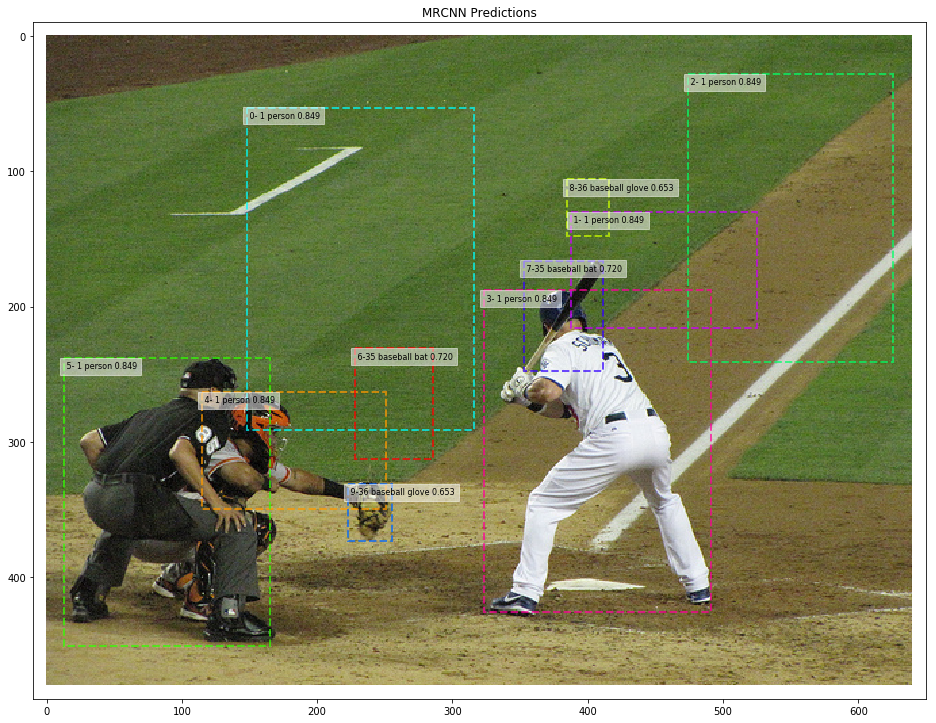

In [14]:
f = fcn_results[0]
print(np.unique(f['gt_class_ids']))
print(np.unique(f['class_ids']))
print('Image Meta: ', f['image_meta'][:10])
visualize.display_instances(f['image'], f['rois'],  f['class_ids'], dataset_test.class_names, f['scores'],
#                             only_classes=[74],
                             title="MRCNN Predictions", score_range=(0.0, 1.7))
#  only_classes=[27],

class ids:  [1, 35, 36]
Image Meta:  [     30533        480        640          3        128          0        896       1024          1          1]


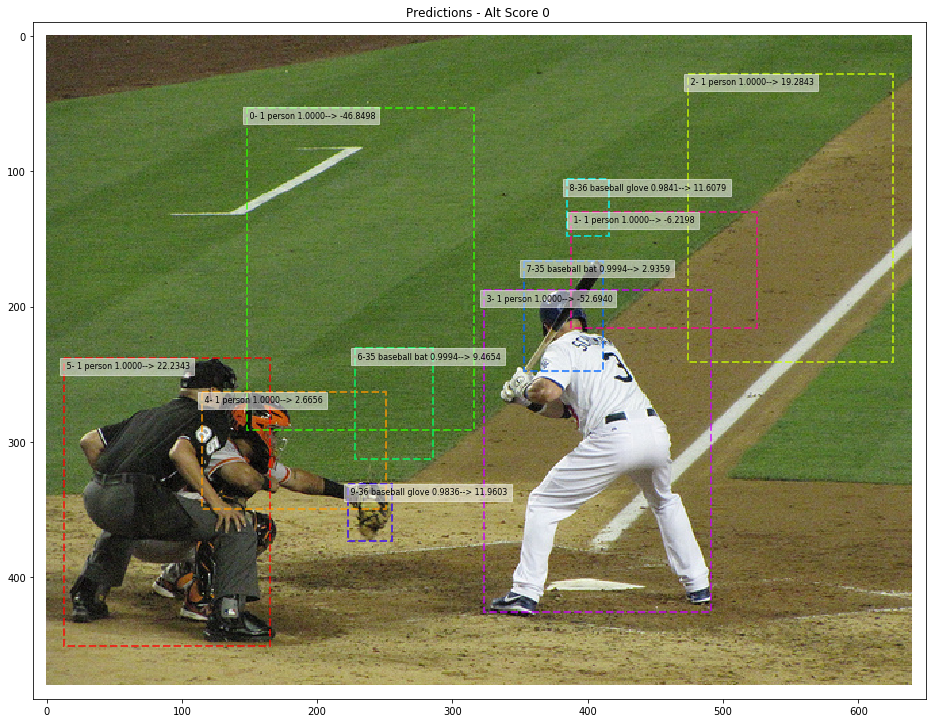

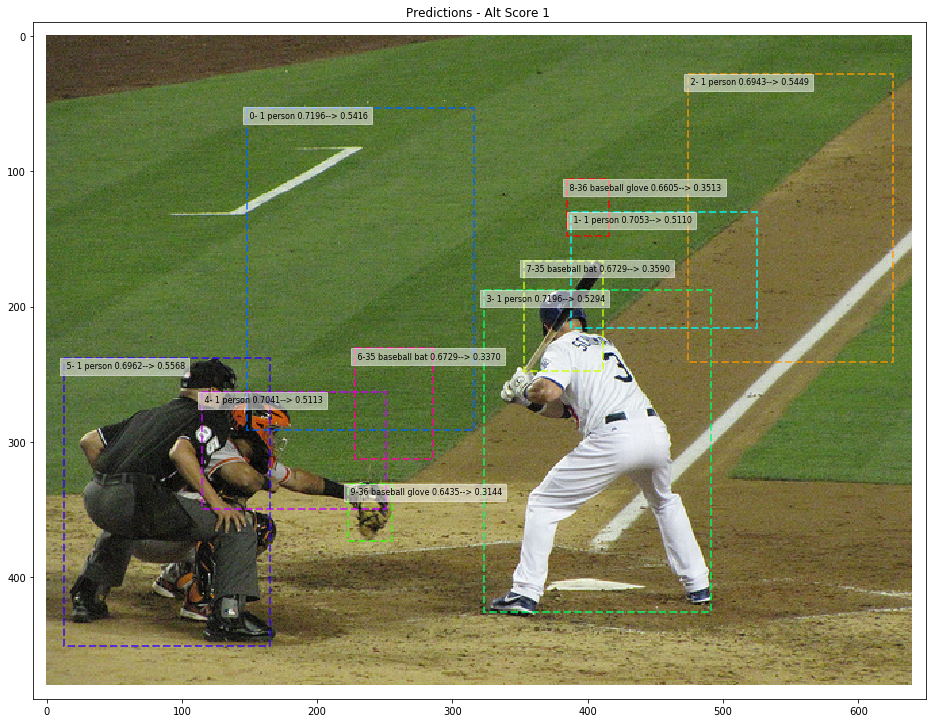

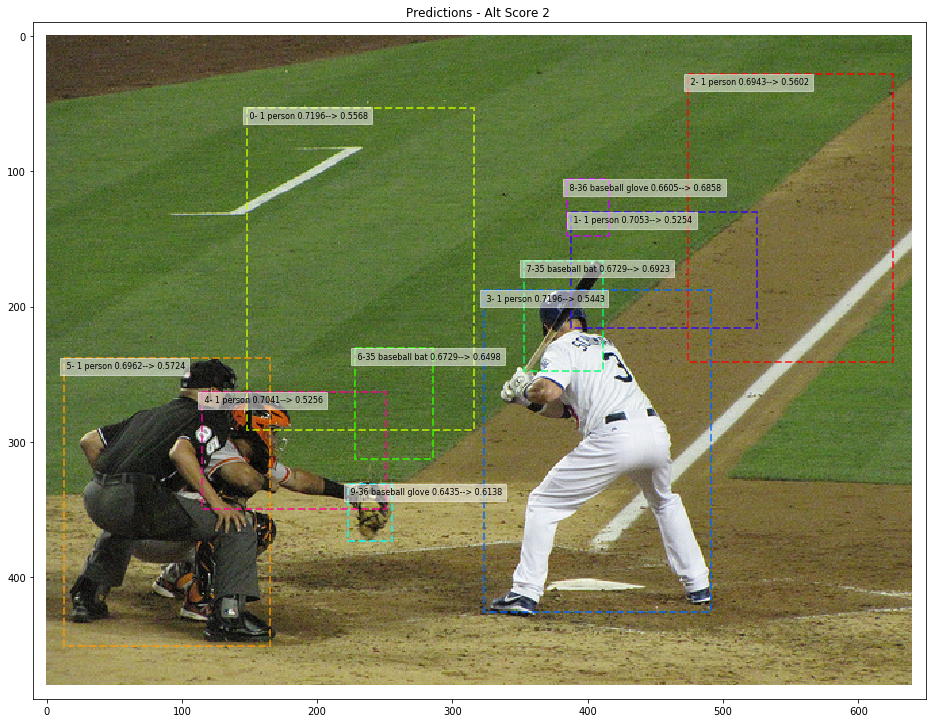

In [15]:
#### Display detections
## old_score   : 11
## alt_score_1 : 14
## alt_score_2 : 20
from mrcnn.utils import log # Display results
# ax = visualize.get_ax(rows =1, cols = 1, size= 20)
f = fcn_results[0]
clses = None
class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
print('Image Meta: ', f['image_meta'][:10])
# visualize.display_instances_from_prscores(f['image'], f['pr_scores'], class_names, score_range=(-999, 9999), only_classes = [1])
# visualize.display_instances(f['image'], f['rois'],  f['class_ids'], class_names, f['scores'], title="Predictions", score_range=(0.7, 0.99), size = 24)
# visualize.display_instances(f['image'], f['rois'], f['class_ids'], class_names, f['scores'], title="Predictions - Orig Score", score_range=(0.0, 1.99), size = 24, only_classes=clses)
visualize.display_instances_two_scores(f['image'], f['rois'], f['class_ids'], class_names, f['pr_scores'][:,11], f['fcn_scores'][:,11],title="Predictions - Alt Score 0 ", only_classes=clses)
visualize.display_instances_two_scores(f['image'], f['rois'], f['class_ids'], class_names, f['pr_scores'][:,14], f['fcn_scores'][:,14],title="Predictions - Alt Score 1 ", only_classes=clses)
visualize.display_instances_two_scores(f['image'], f['rois'], f['class_ids'], class_names, f['pr_scores'][:,20], f['fcn_scores'][:,20],title="Predictions - Alt Score 2 ", only_classes=clses)
# visualize.display_instances_two_scores(f['image'], f['rois'], f['class_ids'], class_names, f['pr_scores'][:,17], f['fcn_scores'][:,17],title="Predictions - Alt Score 1 (Normalized by class)", only_classes=clses)
# visualize.display_instances_two_scores(f['image'], f['rois'], f['class_ids'], class_names, f['pr_scores'][:,23], f['fcn_scores'][:,23],title="Predictions - Alt Score 2 (Normalized by class)", only_classes=clses)


#### Display Img with GT bboxes

 Image_id    :  30533  Reference:  http://cocodataset.org/#explore?id=488487 Coco Id: 488487
 Class ids   :  (5,)    [         1         35         36          1          1]
 Class Names :  ['person', 'baseball bat', 'baseball glove', 'person', 'person']


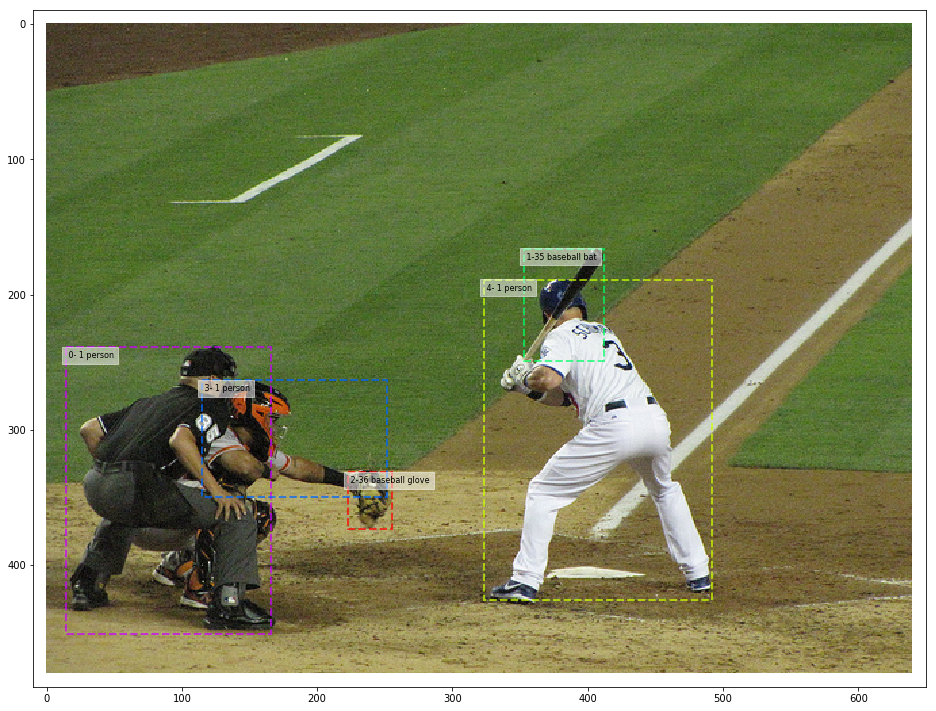

In [16]:
visualize.display_image_gt(dataset_test, mrcnn_model.config, IMAGE_LIST ,
#                            only_classes=[44,46] 
                          )

### Compute mAP and Display Precision/Recall Curve

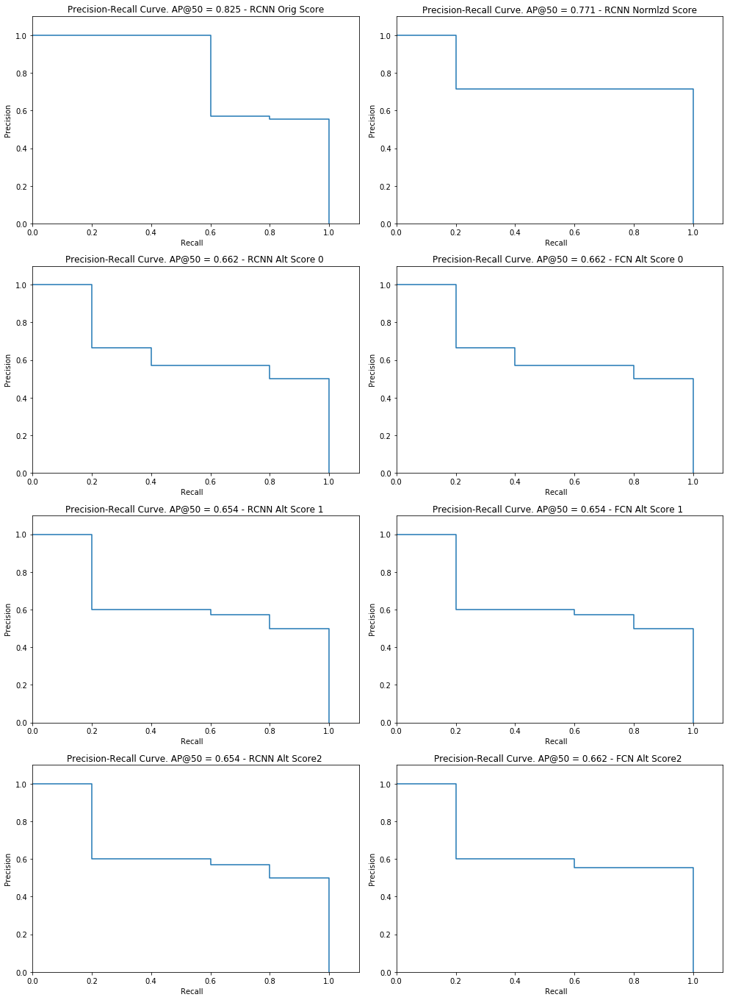

In [17]:
visualize.plot_precision_recall_compare(fcn_results)

In [ ]:
orig_score = 5
norm_score = 8
alt_scr_0  = 11
alt_scr_1  = 14   # in MRCNN alt_scr_1 ans alt_scr_2 are the same
alt_scr_2  = 20

# # Draw precision-recall curve
f = fcn_results[0]
AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['scores'])
visualize.plot_precision_recall(AP, precisions, recalls,ttl = "- Orig Score")
# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['pr_scores'][:,norm_score])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- Normlzd Score")

# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['pr_scores'][:,alt_scr_0])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- RCNN Alt Score 0 ")
# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['fcn_scores'][:,alt_scr_0])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- FCN Alt Score 0 ")

# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['pr_scores'][:,alt_scr_1])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- RCNN Alt Score 1 ")
# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['fcn_scores'][:,alt_scr_1])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- FCN Alt Score 1 ")


# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['pr_scores'][:,alt_scr_2])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- RCNN Alt Score 1 ")
# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['fcn_scores'][:,alt_scr_2])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- FCN Alt Score 1 ")

##  Run MRCNN detection pipeline on second image

In [ ]:
from mrcnn.prep_notebook import get_evaluate_batch
# from mrcnn.prep_notebook import get_training_batch, get_inference_batch, get_evaluate_batch
IMAGE_LIST = [4745]
# eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, generator = test_generator, display = True)
eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, IMAGE_LIST, display = True)

In [ ]:
fcn_results = fcn_model.evaluate(mrcnn_model, eval_batch, verbose =0)

### Display detections on Image

In [ ]:
f = fcn_results[0]
print('Image Meta: ', f['image_meta'][:10])
visualize.display_instances(f['image'], f['rois'],  f['class_ids'], dataset_test.class_names, f['scores'], title="MRCNN Predictions", score_range=(0.0, 0.7))
#  only_classes=[27],

In [ ]:
#### Display detections
## old_score   : 11
## alt_score_1 : 14
## alt_score_2 : 20
from mrcnn.utils import log # Display results
# ax = visualize.get_ax(rows =1, cols = 1, size= 20)
r = fcn_results[0]
clses = [42]
class_ids = np.unique(r['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
print('Image Meta: ', r['image_meta'][:10])

# visualize.display_instances(r['image'], r['rois'],  r['class_ids'], class_names, r['scores'], title="Predictions", score_range=(0.7, 0.99), size = 24)
visualize.display_instances(r['image'], r['rois'],  r['class_ids'], class_names, r['scores'], title="Predictions", score_range=(0.0, 0.99), only_classes= [42], size = 24)
# visualize.display_instances_two_scores(r['image'], r['rois'], r['class_ids'], class_names, r['pr_scores'][:,11], r['fcn_scores'][:,11],title="Predictions", only_classes=clses,size = 24)
visualize.display_instances_two_scores(r['image'], r['rois'], r['class_ids'], class_names, r['pr_scores'][:,14], r['fcn_scores'][:,14],title="Predictions", only_classes=clses,size = 24)
visualize.display_instances_two_scores(r['image'], r['rois'], r['class_ids'], class_names, r['pr_scores'][:,20], r['fcn_scores'][:,20],title="Predictions", only_classes=clses,size = 24)

### Compute mAP and Display Precision/Recall Curve

In [ ]:
old_score   = 11
alt_score_1 = 14
alt_score_2 = 20
# Draw precision-recall curve
f = fcn_results[0]
AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['scores'])
visualize.plot_precision_recall(AP, precisions, recalls)
AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['pr_scores'][:,alt_score_1])
visualize.plot_precision_recall(AP, precisions, recalls)
AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['fcn_scores'][:,alt_score_1])
visualize.plot_precision_recall(AP, precisions, recalls)

##  Run MRCNN detection pipeline on third image

### Load image using `get_evaluate_batch()`

In [ ]:
# 13378, 33816
image, _ = get_inference_batch(dataset_test, mrcnn_model, 13378, display=True)    

In [ ]:
results= run_mrcnn_detection(mrcnn_model,dataset_test, image_id=13378, verbose = 0)
r = results[0]

In [ ]:
print('Image Meta: ', r['orig_image_meta'][:10])
visualize.display_instances(r['image'], r['rois'],  r['class_ids'], dataset_test.class_names, r['scores'], 
                             title="Predictions", score_range=(0.0, 0.7))


#  Compute AP routine

In [94]:
from mrcnn.utils import trim_zeros, compute_overlaps
np_format = {}
float_formatter = lambda x: "%10.4f" % x
int_formatter   = lambda x: "%10d" % x
np_format['float'] = float_formatter
np_format['int']   = int_formatter
np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =10000, formatter = np_format)
def compute_ap(gt_boxes, gt_class_ids,
               pred_boxes, pred_class_ids, pred_scores,
               iou_threshold=0.5):
    '''
    Compute Average Precision at a set IoU threshold (default 0.5).

    Returns:
    mAP:            Mean Average Precision
    precisions:     List of precisions at different class score thresholds.
    recalls:        List of recall values at different class score thresholds.
    overlaps:       [pred_boxes, gt_boxes] IoU overlaps.
    '''
    # Trim zero padding and sort predictions by score from high to low
    # TODO: cleaner to do zero unpadding upstream
    gt_boxes   = trim_zeros(gt_boxes)
    gt_class_ids = trim_zeros(np.expand_dims(gt_class_ids, axis = -1))
    pred_boxes = trim_zeros(pred_boxes)
    pred_scores= pred_scores[:pred_boxes.shape[0]]
    indices    = np.argsort(pred_scores)[::-1]   ## sort indices from largest to smallest
#     print('arg_sort indicies:', indices)
    pred_boxes     = pred_boxes[indices]
    pred_class_ids = pred_class_ids[indices]
    pred_scores    = pred_scores[indices]
    print(gt_boxes.shape, gt_class_ids.shape)
    print(pred_boxes.shape, pred_class_ids.shape, pred_scores.shape)
    print('ground truth:')
    print(np.concatenate([gt_boxes,gt_class_ids], axis = -1))    
    print('predcitions:')
    print(np.concatenate([pred_boxes,np.expand_dims(pred_class_ids, axis = -1), np.expand_dims(pred_scores, axis = -1)], axis = -1))
    print(' Total predicitons: ' , len(pred_scores))
    
    # Compute IoU overlaps [pred_boxes, gt_boxes]
    overlaps = compute_overlaps(pred_boxes, gt_boxes)
    print('overlaps: ',overlaps.shape)
    print(overlaps)
    
    # Loop through ground truth boxes and find matching predictions
    match_count = 0
    pred_match = np.zeros([pred_boxes.shape[0]])
    gt_match   = np.zeros([gt_boxes.shape[0]])
    
    for i in range(len(pred_boxes)):
        # Find best matching ground truth box
        sorted_ixs = np.argsort(overlaps[i])[::-1]
        for j in sorted_ixs:
            # If ground truth box is already matched, go to next one
            if gt_match[j] == 1:
                continue
            # If we reach IoU smaller than the threshold, end the loop
            iou = overlaps[i, j]
            if iou < iou_threshold:
                break
            # Do we have a match?
            if pred_class_ids[i] == gt_class_ids[j]:
                match_count  += 1
                gt_match[j]   = 1
                pred_match[i] = 1
                break
    print(' after overlap computation')
    print('match count:', match_count)
    print('pred_match :', pred_match)
    print('  gt_match :', gt_match)
    
    # Compute precision and recall at each prediction box step
    # Precision = TP / (TP+FP)      Recall = TP / (TP + FN)
    precisions = np.cumsum(pred_match) / (np.arange(len(pred_match)) + 1)
    recalls    = np.cumsum(pred_match).astype(np.float32) / len(gt_match)
    
    print(' precisions')
    print(np.cumsum(pred_match), '/', (np.arange(len(pred_match)) + 1))
    print(precisions)
    print()
    print(' recalls ')
    print(np.cumsum(pred_match), '/', len(gt_match))
    print(recalls)
    print()
    
    # Pad with start and end values to simplify the math
    precisions = np.concatenate([[0], precisions, [0]])
    recalls    = np.concatenate([[0], recalls, [1]])
    print('appended [0/0], [0/1] to front/end of precisions/recalls')
    print(' Pr: ', precisions)
    print(' Rc: ', recalls)
    print()
    
    
    # Ensure precision values decrease but don't increase. This way, the
    # precision value at each recall threshold is the maximum it can be
    # for all following recall thresholds, as specified by the VOC paper.
    for i in range(len(precisions) - 2, -1, -1):
        precisions[i] = np.maximum(precisions[i], precisions[i + 1])
    print('backtracking precsiosn values:', list(range(len(precisions) - 2, -1, -1)))
    print(' Pr: ', precisions)
    print(' Rc: ', recalls)
    print()
    
    # Compute mean AP over recall range
    print(' Rc[:-1] : ', recalls[:-1])
    print(' Rc[1:]  : ', recalls[1:])
    print(' Pr[1:]  : ', precisions[1:])
    print()

    ## find points where recall values changes 
    indices = np.where(recalls[:-1] != recalls[1:])[0] + 1
    mAP     = np.sum((recalls[indices] - recalls[indices - 1]) * precisions[indices])
    
    print('where recalls[:-1] != recalls[1:]:', np.where(recalls[:-1] != recalls[1:]))
    print('indices at recall changes : ', indices)
    print(' A1: recall[indices]  : ', recalls[indices])
    print(' A2: recall[indices-1]: ', recalls[indices-1])
    print(' A1 - A2              : ', (recalls[indices] - recalls[indices - 1]))
    print(' P1:precision[indices]: ', precisions[indices])
    print(' (A1-A2)*P1           : ', (recalls[indices] - recalls[indices - 1]) * precisions[indices])
    print(' Sum = mAP            : ', mAP)
    print(' Pr        : ', precisions)
    print(' Rc        : ', recalls)
    print(' Pr*Rc     : ', precisions*recalls)
    print(' Sum(Pr*Rc): ', np.sum(precisions*recalls))
    print(' Sum(Pr*Rc)/m: ', np.sum(precisions*recalls)/len(precisions))
    return mAP, precisions, recalls, overlaps

(100, 4) (100,)
(8, 4) (8, 1)
(21, 4) (21,) (21,)
ground truth:
[[       445        787        687        915         40]
 [       378        735        644        856         40]
 [       170          5        520        342          1]
 [       363          0        847        398          1]
 [       676        261        770        403         44]
 [       493        378        762        723         56]
 [       170        659        349        959          1]
 [       170        775        451       1023          1]]
predcitions:
[[  218.0000    10.0000   853.0000   359.0000     1.0000     0.9897]
 [  426.0000   787.0000   698.0000   916.0000    40.0000     0.9753]
 [  380.0000   168.0000   646.0000   289.0000    40.0000     0.9753]
 [  337.0000   109.0000   579.0000   237.0000    40.0000     0.9753]
 [  172.0000   693.0000   428.0000  1013.0000     1.0000     0.9641]
 [  262.0000   301.0000   531.0000   646.0000    56.0000     0.9570]
 [  484.0000   342.0000   764.0000   728.000

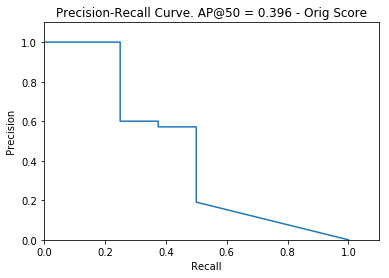

In [96]:
orig_score = 5
norm_score = 8
alt_scr_0  = 11
alt_scr_1  = 14   # in MRCNN alt_scr_1 ans alt_scr_2 are the same
alt_scr_2  = 20

# AP, precisions, recalls, overlaps = compute_ap(gt_data[0]['gt_bbox'], gt_data[0]['gt_class_id'], r['molded_rois'], r['class_ids'], r['scores'])
f = fcn_results[0]
print(f['gt_bboxes'].shape, f['gt_class_ids'].shape)
AP, precisions, recalls, overlaps = compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['pr_scores'][:,orig_score])
visualize.plot_precision_recall(AP, precisions, recalls,ttl = "- Orig Score")

In [ ]:
len(precisions)
precisions


In [ ]:
f = fcn_results[0]
f.keys()

# Display Heatmaps

In [26]:
# from mrcnn.visualize import (plot_one_bbox_heatmap, 
#                              plot_3d_heatmap, plot_2d_heatmap, 
#                               plot_2d_heatmap_compare, plot_3d_heatmap_compare)
# import matplotlib as plt
# %matplotlib inline
img_id = 0
f= fcn_results[img_id]
image_id=f['image_meta'][0]
print('Image id: ',image_id, ' Coco ID: ', dataset_test.image_info[image_id]['id'])
print(f['pr_scores'][:,4])
coco_class_names = dataset_test.class_names
gt_class_ids = np.unique(f['gt_class_ids']).astype(int).tolist()
pr_class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
fcn_class_ids = np.unique(f['fcn_scores'][:,4]).astype(int).tolist()
print('  GT class ids: ', gt_class_ids)
print('Pred class ids: ', pr_class_ids)
print('FCN  class ids: ', fcn_class_ids)

Image id:  30533  Coco ID:  488487
[    1.0000     1.0000     1.0000     1.0000     1.0000     1.0000    35.0000    35.0000    36.0000    36.0000]
  GT class ids:  [0, 1, 35, 36]
Pred class ids:  [1, 35, 36]
FCN  class ids:  [1, 35, 36]


## Overlay images with heatmaps

### Overlay image with pred_heatmaps

class ids:  [1, 35, 36]
 Scaling options are:  'all', 'class'/'each' , or  'clip' 
 heatmap shape:  (256, 256, 81)  Bounding boxes shape:  (81, 200, 24)
Display classes: [1, 35, 36]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


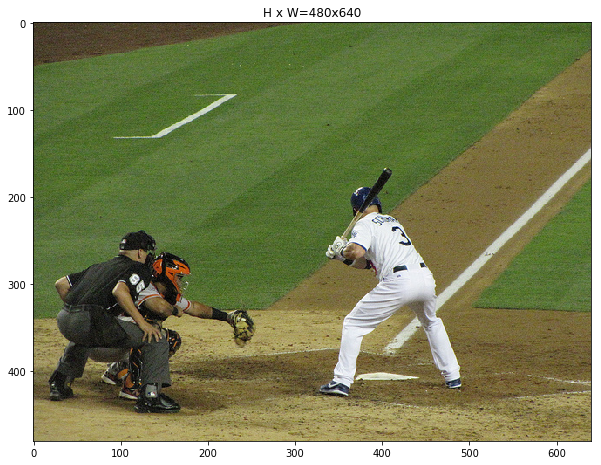

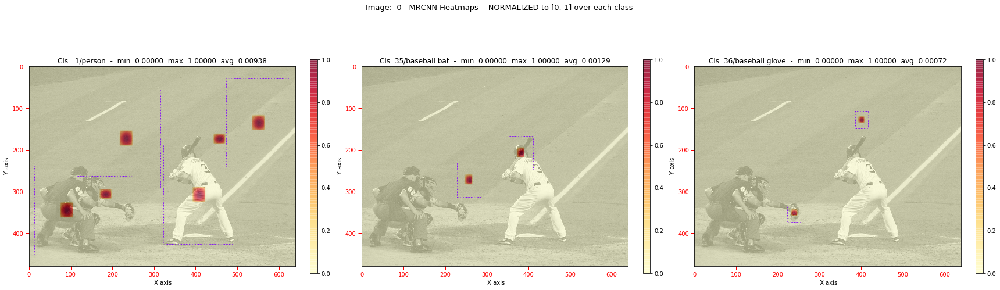

In [19]:
from mrcnn.visualize import display_heatmaps, display_heatmaps_fcn, display_heatmaps_mrcnn, inference_heatmaps_display
# visualize.display_image_bw(image)
# print(model_gt_heatmap_scores.shape)
class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
inference_heatmaps_display(fcn_results, 0, class_ids = class_ids, class_names = coco_class_names, hm = 'pr_hm' ,config = mrcnn_model.config, scaling = 'class', columns = 4) 
# , display_heatmaps_mrcnn(train_batch_x, model_output, 0, hm = 'pr',  
#                      config = mrcnn_config, class_ids = class_ids)

### Overlay image with fcn_heatmaps

class ids:  [1, 35, 36]
 Scaling options are:  'all', 'class'/'each' , or  'clip' 
 heatmap shape:  (256, 256, 81)  Bounding boxes shape:  (81, 200, 24)
Display classes: [1, 35, 36]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


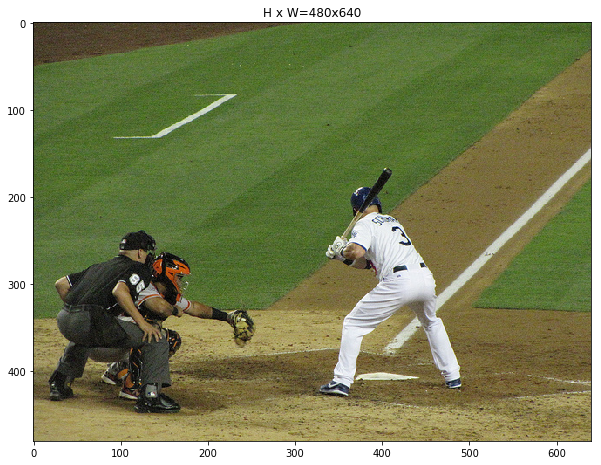

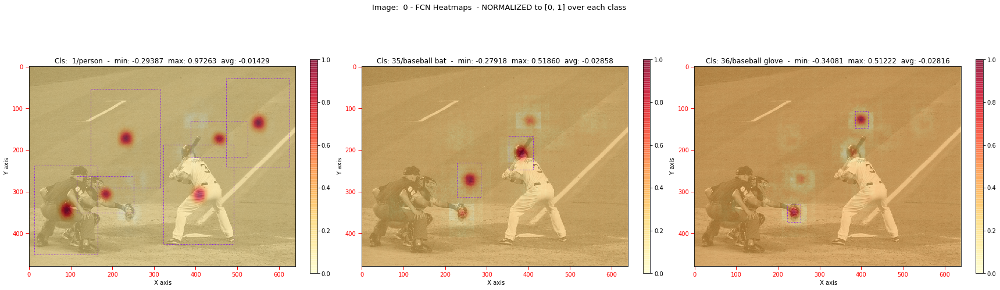

In [20]:
from mrcnn.visualize import display_heatmaps, display_heatmaps_fcn, display_heatmaps_mrcnn, inference_heatmaps_display
# visualize.display_image_bw(image)
# print(model_gt_heatmap_scores.shape)
class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
inference_heatmaps_display(fcn_results, 0, class_ids = class_ids, class_names = coco_class_names, hm = 'fcn_hm' ,config = mrcnn_model.config, scaling = 'class', columns = 4) 
# , display_heatmaps_mrcnn(train_batch_x, model_output, 0, hm = 'pr',  

### Overlay image with pr_heatmaps and fcn_heatmaps

 Scaling options are: 'all', 'class', 'each' , or  'clip' : 
 heatmap shape:  (256, 256, 81)
 Bounding boxes shape:  (81, 200, 24)
Image shape : (338, 451, 3)  class_ids: [        42         43         44         45         46         50         56         61         74         80]
 SCALING == clip (clip to [-1, +1])


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


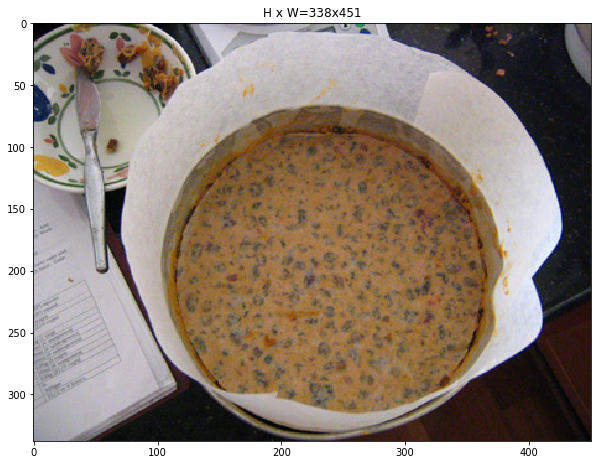

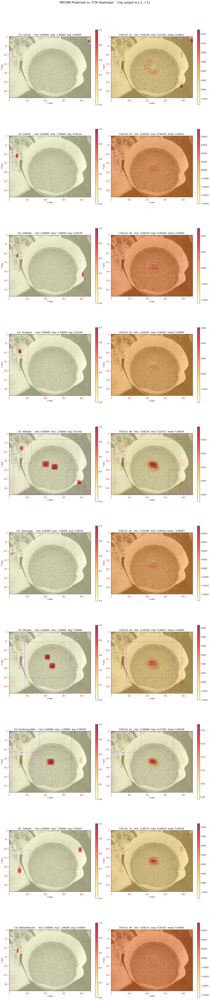

In [66]:
visualize.inference_heatmaps_compare(fcn_results, image_id = 0 , hm = 'fcn_hm', 
                     config = mrcnn_model.config, class_ids = pr_class_ids, class_names = coco_class_names, scaling = 'clip')

## 2D Plots

###  2D plot of `model_gt_heatmap`  

In [25]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
visualize.plot_2d_heatmap(model_gt_heatmap, model_gt_heatmap_scores, img_id, gt_class_ids, 
                 class_names = coco_class_names, columns = 3, scale = 4, scaling = 'all')

Image : 0  ClassIds: [0, 1, 35, 36]


NameError: name 'model_gt_heatmap' is not defined

###  2D plot of `model_pred_heatmap` (w/ Ground Truth Bounding Boxes)

Image : 0  ClassIds: [1, 35, 36]
 Scaling options are 'all', 'class'/'each', 'clip', or 'none' 
 Shape of Z:  (256, 256, 81)  boxes:  (81, 200, 24)
 Image Id:  0  Display classes: [0, 1, 35, 36]
 rows   1  columns : 5 boxes.shape :  (81, 200, 24)
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 


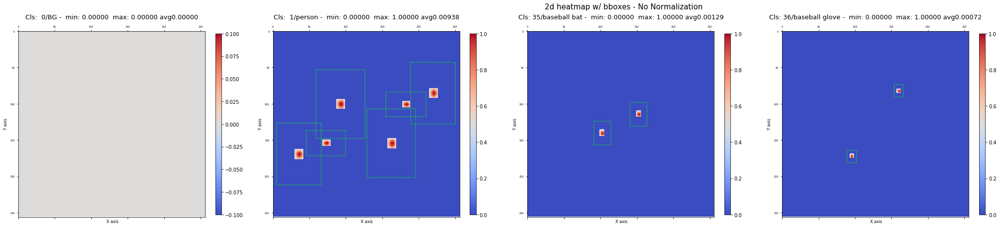

In [27]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
_ = visualize.plot_2d_heatmap(f['pr_hm'], f['pr_hm_scores'],0, gt_class_ids, columns = 5,
                             class_names = coco_class_names, scale = 4, scaling = 'none')

###  2D plot of `model_fcn_heatmap` (w/ GT Bounding Boxes)

Image : 0  ClassIds: [0, 1, 35, 36]
 Scaling options are 'all', 'class'/'each', 'clip', or 'none' 
 Shape of Z:  (256, 256, 81)  boxes:  (81, 200, 24)
 Image Id:  0  Display all classes...
 rows   27  columns : 3 boxes.shape :  (81, 200, 24)
 min_z_all shape: ()  min_z_all: -0.5003417  max_z_all: () max_z_all: 0.9726291
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == class


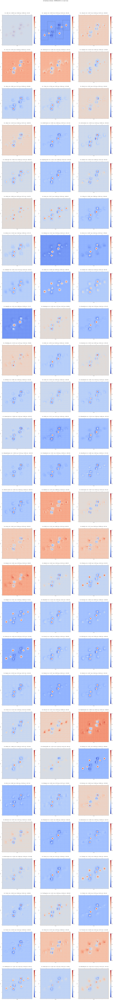

In [39]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
disp_classes = range()
_ = visualize.plot_2d_heatmap(f['fcn_hm'], f['fcn_hm_scores'],img_id, [] columns = 3, size=(9,9),
                             class_names = coco_class_names, scale = 4, scaling = 'class')

###  2D plot of `model_fcn_heatmap` (w/ MRCNN PREDICTED Bounding Boxes)

In [ ]:
print(model_fcn_heatmap.shape)
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
fig  = visualize.plot_2d_heatmap(model_fcn_heatmap, model_fcn_scores,img_id, pr_class_ids, columns = 5,
                             class_names = coco_class_names, scale = 4, scaling = 'class')

####  2D plot of `model_fcn_heatmap` returned from model - ALL CLASSES

In [ ]:
# class_ids = np.unique(model_pred_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
# print('Image : {}  Pred ClassIds: {}'.format(img_id, class_ids))
# fig  = visualize.plot_2d_heatmap(model_fcn_heatmap, model_fcn_scores, img_id, 
#                                  columns = 5, class_names = coco_class_names, scale = 4, scaling = 'class')    
#     fig.savefig('fcn_heatmaps_2d.png')

####  2D comparative display `pred_heatmap` / `fcn_heatmap`  

In [ ]:
for img_id in [0]: ##range(mrcnn_config.BATCH_SIZE):
    class_ids = np.unique(model_pred_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
#     class_ids = list(range(30))
    _ = visualize.plot_2d_heatmap_compare(model_pred_heatmap, model_fcn_heatmap, model_pred_heatmap_scores, 
                            img_id, class_ids = class_ids, class_names = coco_class_names, scale = 4, scaling = 'class' )    

##  3D Plots

###  3D plot of `fcn_heatmap` returned form model - classes predicted by MRCNN only 

In [ ]:
print(np.max(f['fcn_hm']), np.min(f['fcn_hm']))

print(f['fcn_hm'].shape)
class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
plot_3d_heatmap(f['fcn_hm'], 0, class_ids,class_names = coco_class_names, scaling = 'none')

###  3D plot of `fcn_softmax` returned form model - only classes in pred_scores

In [ ]:
for img_id in [0]: ##range(mrcnn_config.BATCH_SIZE):
    print(f['fcn_hm'].shape)
    class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
    plot_3d_heatmap(f['fcn_sm'], 0, class_ids,class_names = coco_class_names, scaling = 'none')

# Run Object Detection on samples in Images folder

### Test on a random image from images folder

In [ ]:
# Load a random image from the images folder
# import mrcnn.visualize as visualize
import random
import skimage.io
import matplotlib.pyplot as plt
IMAGE_DIR = 'E:/git_projs/mrcnn3/images'
# IMAGE_DIR = '/esat/tiger/joramas/mscStudentsData/kbardool/projs/mrcnn3/images'
file_names = next(os.walk(IMAGE_DIR))[2]
# print(file_names)
random_filename = random.choice(file_names)
print(random_filename)
image = skimage.io.imread(os.path.join(IMAGE_DIR, random_filename))
plt.figure(figsize=(11,11))
plt.imshow(image)

In [ ]:
# Run detection
# results = mrcnn_model.detect([image], verbose=1)
results = fcn_model.detect_from_images(mrcnn_model, [image], verbose=1)

###  Test on loaded image

In [ ]:
# Visualize results
r = results[0]
for bbox, cls, scr in zip(r['rois'], r['class_ids'],  r['scores']):
    print('{}    {:2d}    {:.<20s}  {:5.4f} '.format(bbox, cls, dataset_test.class_names[cls], scr))
visualize.display_instances(image, r['rois'], r['class_ids'], dataset_test.class_names, r['scores']) #, score_range=(0.21, 0.22))

In [ ]:
r = results[0]
for bbox, cls, scr in zip(r['rois'], r['class_ids'],  r['scores']):
    print('{}    {:2d}    {:.<20s}  {:5.4f} '.format(bbox,cls,dataset_test.class_names[cls], scr))
visualize.display_instances(image, r['rois'], r['class_ids'], dataset_test.class_names, r['scores'], ax=visualize.get_ax(size=16))

###  Display random image from test dataset

In [ ]:
# Load random image and mask. ### 27711 persons and boats
image_id = np.random.choice(dataset_test.image_ids)
image    = dataset_test.load_image(image_id)
mask, class_ids = dataset_test.load_mask(image_id)
# Compute Bounding box
bbox = utils.extract_bboxes(mask)

# Display image and additional stats
print("image_id ", image_id, dataset_test.image_reference(image_id))
log("image", image)
log("mask", mask)
log("class_ids", class_ids)
log("bbox", bbox)
print(class_ids.shape[0], bbox.shape[0])
# Display image and instances
# visualize.display_instances_with_mask(image, bbox, mask, class_ids, dataset_train.class_names)
visualize.display_instances(image, bbox, class_ids, dataset_test.class_names)

In [ ]:
results = mrcnn_model.detect([image], verbose=1)

In [ ]:
print('resutls :', results)
# Visualize results
r = results[0]
for bbox, cls, scr in zip(r['rois'], r['class_ids'],  r['scores']):
    print('{}    {:2d}    {:.<20s}  {:5.4f} '.format(bbox,cls,dataset_test.class_names[cls], scr))
visualize.display_instances(image, r['rois'], r['class_ids'], dataset_test.class_names, r['scores'])

### Test on a random image from test dataset

In [ ]:
# Test on a random image
# Validation dataset
# dataset_val = shapes.ShapesDataset()
# dataset_val.load_shapes(50, config.IMAGE_SHAPE[0], config.IMAGE_SHAPE[1])
# dataset_val.prepare()

image_id = random.choice(dataset_test.image_ids)
original_image, image_meta, gt_class_id, gt_bbox =\
    load_image_gt(dataset_test, mrcnn_config, image_id, use_mini_mask=False)
    

print('Image Id :', image_id)    
shape_list = dataset_test.image_info[image_id] 
pp.pprint(shape_list)
log("original_image", original_image)
log("image_meta", image_meta)
print(image_meta)
log("gt_class_id", gt_bbox)
log("gt_bbox", gt_bbox)
# log("gt_mask", gt_mask)

print(" 1: person   2: car  3: sun  4: building  5: tree  6: cloud ")
visualize.display_instances(original_image, gt_bbox, gt_class_id, 
                            dataset_test.class_names, figsize=(8, 8))

In [ ]:
results = model.detect([original_image], verbose=1)

In [ ]:
r = results[0]
print('  rois       : ', r['rois'])
print('  masks      : ', r['masks'].shape)
print('  class ids  : ', r['class_ids'])
print('  class names: ', dataset_test.class_names)
print('  scores     : ', r['scores'])
visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                            dataset_test.class_names, r['scores'], ax=get_ax())

# Evaluation of mAP  over a number of images

##  Modified Version for MRCNN - FCN 

In [76]:
# Compute VOC-Style mAP @ IoU=0.5
# Running on 10 images. Increase for better accuracy.
from mrcnn.datagen     import data_generator, load_image_gt
import  mrcnn.utils as utils 

orig_score = 5
norm_score = 8
alt_scr_0  = 11
alt_scr_1  = 14   # in MRCNN alt_scr_1 ans alt_scr_2 are the same
alt_scr_2  = 20

image_ids = np.random.choice(dataset_test.image_ids, 50)
print(image_ids)
# APs = []
MRCNN_AP_Orig = []
MRCNN_AP_0 = [] 
MRCNN_AP_1 = [] 
MRCNN_AP_2 = []
FCN_AP_0   = []
FCN_AP_1   = []
FCN_AP_2   = []
for image_id in image_ids:
    # Load image and ground truth data
    print('==> Calculate AP for image_id : ', image_id)
    # Run object detection
    eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, image_id, display = False)    
    fcn_results = fcn_model.evaluate(mrcnn_model, eval_batch, verbose =0)    
    r = fcn_results[0] 
    
    # Compute AP
#     AP, precisions, recalls, overlaps
    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'], r["molded_rois"], r["class_ids"], r["pr_scores"][:,orig_score])
#     print('   MRCNN_AP_Orig:', AP)
    MRCNN_AP_Orig.append(AP)
    
    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'], r["molded_rois"], r["class_ids"], r["pr_scores"][:,alt_scr_0])
#     print('   MRCNN_AP_0   :', AP)
    MRCNN_AP_0.append(AP)
    
    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'],  r["molded_rois"], r["class_ids"], r["fcn_scores"][:,alt_scr_0])
#     print('   FCN_AP_0   :', AP)
    FCN_AP_0.append(AP)

    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'],  r["molded_rois"], r["class_ids"], r["pr_scores"][:,alt_scr_1])
#     print('   MRCNN_AP_1   :', AP)
    MRCNN_AP_1.append(AP)
    
    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'],  r["molded_rois"], r["class_ids"], r["fcn_scores"][:,alt_scr_1])
#     print('   FCN_AP_1   :', AP)
    FCN_AP_1.append(AP)
    

    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'],  r["molded_rois"], r["class_ids"], r["pr_scores"][:,alt_scr_2])
#     print('   MRCNN_AP_2   :', AP)
    MRCNN_AP_2.append(AP)
    
    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'],  r["molded_rois"], r["class_ids"], r["fcn_scores"][:,alt_scr_2])
#     print('   FCN_AP_2   :', AP)
    FCN_AP_2.append(AP)
    
# print("mAP: ", np.mean(APs))

[     13356      34764      41260       9188      54289      47874       6457      51716       8191      49603      27279       6819        928       6275      56244      34283      46505
       6364      15725       9591      53890      13512      22415      49675      54956      26969       7454      49217      29352      17420      25157      13450      44724      36259
      39904      40925      46205      30384      32061      55117      10176      18097      27647      44761      32215      54040      41001      21921      26251      25445]
==> Calculate AP for image_id :  13356


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\numpy\lib\function_base.py:1128: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\numpy\core\_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)



==> Calculate AP for image_id :  34764

==> Calculate AP for image_id :  41260


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\scipy\ndimage\interpolation.py:583: UserWarning: From scipy 0.13.0, the output shape of zoom() is calculated with round() instead of int() - for these inputs the size of the returned array has changed.
  "the returned array has changed.", UserWarning)



==> Calculate AP for image_id :  9188

==> Calculate AP for image_id :  54289

==> Calculate AP for image_id :  47874

==> Calculate AP for image_id :  6457

==> Calculate AP for image_id :  51716

==> Calculate AP for image_id :  8191

==> Calculate AP for image_id :  49603

==> Calculate AP for image_id :  27279

==> Calculate AP for image_id :  6819

==> Calculate AP for image_id :  928

==> Calculate AP for image_id :  6275

==> Calculate AP for image_id :  56244

==> Calculate AP for image_id :  34283

==> Calculate AP for image_id :  46505

==> Calculate AP for image_id :  6364

==> Calculate AP for image_id :  15725

==> Calculate AP for image_id :  9591

==> Calculate AP for image_id :  53890

==> Calculate AP for image_id :  13512

==> Calculate AP for image_id :  22415

==> Calculate AP for image_id :  49675

==> Calculate AP for image_id :  54956

==> Calculate AP for image_id :  26969

==> Calculate AP for image_id :  7454

==> Calculate AP for image_id :  49217

==> Calcu

In [78]:
print('done')
from mrcnn.utils import trim_zeros, compute_overlaps
np_format = {}
float_formatter = lambda x: "%10.4f" % x
int_formatter   = lambda x: "%10d" % x
np_format['float'] = float_formatter
np_format['int']   = int_formatter
np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =10000, formatter = np_format)

done


In [79]:
print(" {:>13s} {:>13s} {:>13s} {:>13s} {:>13s} {:>13s} {:>13s}".format("MRCNN_AP_Orig", "MRCNN_AP_0", "FCN_AP_0", "MRCNN_AP_1", "FCN_AP_1", "MRCNN_AP_2", "FCN_AP_2"))
for i in range(len(MRCNN_AP_Orig)):
    print(" {:13.5f} {:13.5f} {:13.5f} {:13.5f} {:13.5f} {:13.5f} {:13.5f}".format(
        MRCNN_AP_Orig[i], MRCNN_AP_0[i], FCN_AP_0[i], MRCNN_AP_1[i], FCN_AP_1[i], MRCNN_AP_2[i], FCN_AP_2[i]))
print()
print()


print(" {:>13s} {:>13s} {:>13s} {:>13s} {:>13s} {:>13s} {:>13s}".format("MRCNN_AP_Orig", "MRCNN_AP_0", "FCN_AP_0", "MRCNN_AP_1", "FCN_AP_1", "MRCNN_AP_2", "FCN_AP_2"))
print('-'*160)
print(" {:13.5f} {:13.5f} {:13.5f} {:13.5f} {:13.5f} {:13.5f} {:13.5f}".format(
        np.mean(MRCNN_AP_Orig), np.mean(MRCNN_AP_0), np.mean(FCN_AP_0), np.mean(MRCNN_AP_1), np.mean(FCN_AP_1), np.mean(MRCNN_AP_2), np.mean(FCN_AP_2)))        

 MRCNN_AP_Orig    MRCNN_AP_0      FCN_AP_0    MRCNN_AP_1      FCN_AP_1    MRCNN_AP_2      FCN_AP_2
       0.15415       0.18563       0.12032       0.16302       0.12032       0.16302       0.12032
       0.33333       0.35833       0.30619       0.30907       0.30619       0.30907       0.30619
       0.72222       0.66667       0.61905       0.50000       0.47619       0.50000       0.47619
       0.46997       0.52791       0.44559       0.44124       0.33481       0.33417       0.30900
       0.83333       0.83333       0.83333       0.83333       0.83333       0.83333       0.83333
       0.38235       0.28431       0.24644       0.26471       0.13552       0.24013       0.14171
       0.83333       0.66667       0.45000       0.83333       0.45000       0.83333       0.45000
       0.02255       0.02421       0.06836       0.02658       0.06836       0.02542       0.06836
       0.54479       0.55875       0.38286       0.53424       0.31042       0.45841       0.31042
       0.4

In [ ]:
f.keys()

##  Original Version

In [73]:
# # Compute VOC-Style mAP @ IoU=0.5
# # Running on 10 images. Increase for better accuracy.
# from mrcnn.datagen     import data_generator, load_image_gt
# import  mrcnn.utils as utils 

# image_ids = np.random.choice(dataset_test.image_ids, 10)
# APs = []
# for image_id in image_ids:
#     # Load image and ground truth data
#     image, image_meta, gt_class_id, gt_bbox, gt_mask =\
#         load_image_gt(dataset_test, mrcnn_config,
#                                image_id, use_mini_mask=False)
#     molded_images = np.expand_dims(utils.mold_image(image, mrcnn_config), 0)
#     # Run object detection
#     results = mrcnn_model.detect([image], verbose=0)
#     r = results[0]
#     # Compute AP
#     AP, precisions, recalls, overlaps =\
#         utils.compute_ap(gt_bbox, gt_class_id,
#                          r["rois"], r["class_ids"], r["scores"])
#     APs.append(AP)
    
# print("mAP: ", np.mean(APs))